In [1]:
import pandas as pd
import numpy as np
import re
import random
import os
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud, STOPWORDS
from tqdm import tqdm
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import torch
from torch.utils.data import DataLoader
from transformers import AutoModel, AutoTokenizer

%matplotlib inline

pd.options.display.max_colwidth = 300

import warnings
warnings.filterwarnings('ignore')

In [2]:
RANDOM_SEED = 2906

def seed_everything(seed: int):  
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True
    
seed_everything(RANDOM_SEED)

#### EDA

**Loading dataset:**

In [3]:
import kaggle
kaggle.api.authenticate() 
kaggle.api.competition_download_files(
    competition='jigsaw-toxic-comment-classification-challenge',
    path='data', quiet=True
    )

In [4]:
import zipfile
archive = 'data/jigsaw-toxic-comment-classification-challenge.zip'
with zipfile.ZipFile(archive, 'r') as zip_file:
    zip_file.extractall('data')

archive_csv = 'data/train.csv.zip'
with zipfile.ZipFile(archive_csv, 'r') as zip_file:
    zip_file.extractall('data')

In [5]:
train = pd.read_csv('data/train.csv')

train.sample(5)

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
67770,b554c337ff97e3da,"I don't have time to wait for Wikia support to reply, please unblock me. I don't want to wait 16 days, 384 hours to edit again. Just unblock me so i can edit on all wikias and on my wiki, Memory Delta wiki. You blocked me, if you just unblock me i will leave you alone on wiki. Just unblock me al...",0,0,0,0,0,0
71669,bfe20e99f3420e4b,"I am from Bolton,and from my experience going to Bury i would say that the older Bury Locals pronounce the name as Burri whereas younger Locals say Berri.However in Bolton both young and old\nBoltonians say Burri.",0,0,0,0,0,0
13506,23a49413c4b5037a,"""\n\nTreatment is about treatment; secondary prevention belongs after treatment. Prophylaxis should be in a different section altogether.\nI agree that we need to be clear that thrombolysis is not a treatment for haemorrhagic stroke.\nHypothermia is listed as """"experimental"""" by the Donnan et al...",0,0,0,0,0,0
2454,068e14faad3180b8,"""\n\nLet me get this straight, my last post, is cause for you to post something on mine saying last warning I'm going to be banned? I didn't 'accuse' you of enlisting someone else, I thought you had but you didn't it turns out, so basically by saying """"are you trying to bore me?"""" that is why yo...",0,0,0,0,0,0
153486,9d9a990822eeb1cd,"And what if the lake's outlet to sea is not clearly titled as a river? Also: how should we regard watercourses (rivers?) which appear via Ynglis to have acquired the title Water? 17:00, 14 Mar 2005 (UTC).",0,0,0,0,0,0


**Explore:**

In [6]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159571 entries, 0 to 159570
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   id             159571 non-null  object
 1   comment_text   159571 non-null  object
 2   toxic          159571 non-null  int64 
 3   severe_toxic   159571 non-null  int64 
 4   obscene        159571 non-null  int64 
 5   threat         159571 non-null  int64 
 6   insult         159571 non-null  int64 
 7   identity_hate  159571 non-null  int64 
dtypes: int64(6), object(2)
memory usage: 9.7+ MB


In [7]:
train.duplicated().sum()

np.int64(0)

Add `neutral` feature:

In [8]:
def set_neutral(data):
    data['neutral'] = 1
    data['neutral'] = (data['toxic'] == 0) & (data['severe_toxic'] == 0) & \
                      (data['obscene'] == 0) & (data['threat'] == 0) & \
                      (data['insult'] == 0) & (data['identity_hate'] == 0)
    data['neutral'] = data['neutral'].astype(int)
    return data

In [9]:
train = set_neutral(train)

#### Distribution

Length of the comment:

In [10]:
train['comment_len'] = train['comment_text'].apply(lambda x: len(x.split(' ')))

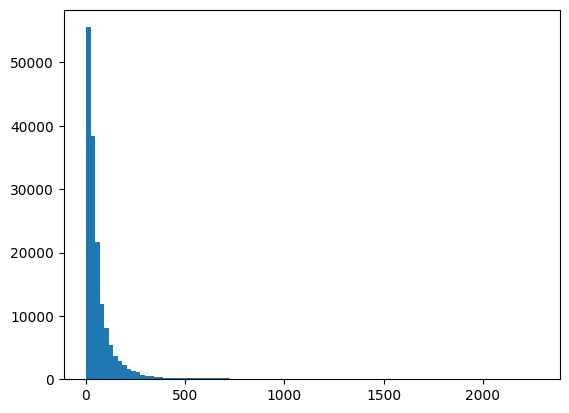

In [11]:
plt.hist(train['comment_len'], bins=100)
plt.show()

In [12]:
len(train[train['comment_len'] > 300])

4865

Drop long comments:

In [13]:
long_comments = train[train['comment_len'] > 300].index
train = train.drop(long_comments, axis=0).reset_index(drop=True)

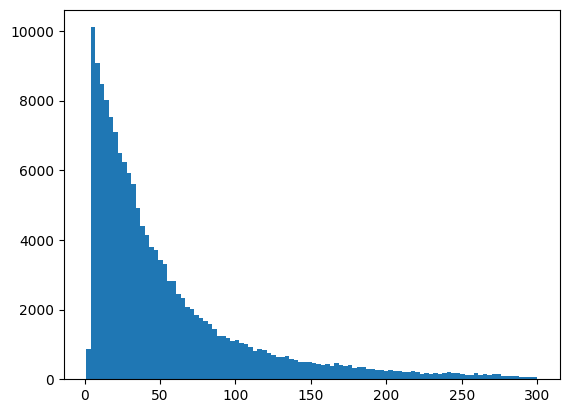

In [14]:
plt.hist(train['comment_len'], bins=100)
plt.show()

Types of hatespeach:

In [15]:
fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=('toxic', 'severe_toxic', 'obscene',
                    'threat', 'insult', 'identity_hate')
                    )

for i, column in enumerate(train.columns[2:-2]):
    fig.add_trace(
        go.Histogram(x=train[column], name=column),
        row=1 + (i // 3),
        col=1 + (i % 3)
    )

for i in range(1, 3):
    for j in range(1, 4):
        fig.update_xaxes(
            tickvals=[0, 1],
            row=i, col=j
        )

fig.update_layout(
    width=900,
    height=800,
    title_text='Distribution of data by toxicity',
    title_x=0.5,
    bargap=0.1
)

fig.show()

In [46]:
fig = px.histogram(train, x='neutral')

fig.update_layout(
    width=600,
    height=500,
    title_text='Ratio of toxic and neutral messages',
    bargap=0.1,
    xaxis_tickvals=[0, 1]
)

fig.show()

#### Normalization

Clean text manualy:

In [17]:
def clean_text(text):
    text = str(text)
    text = re.sub(r'http\S+', '', text)
    text = re.sub(r'@\S+', '', text)
    text = re.sub('\s+', ' ', text)
    text = re.sub('\d+', '', text)
    text = re.sub(r'#\w+', '', text)
    text = re.sub(r'\- ', '', text)
    text = re.sub(r' \-', '', text)
    text = text.lower()
    return text.strip()

def replace_emojis(text):
  '''
  token [EMOJI]
  '''
  emojis = re.findall(
     r'[\U0001F600-\U0001F64F\U0001F300-\U0001F5FF\U0001F680-\U0001F6FF\U0001F1E0-\U0001F1FF]+',
     text
     )
  for emoji in emojis:
    text = text.replace(emoji, '[EMOJI]')
  return text

In [18]:
sample_raw1 = train['comment_text'][5]
sample_raw2 = train['comment_text'][753]
sample_raw3 = train['comment_text'][843]
sample_raw4 = train['comment_text'][69]
sample_raw5 = train['comment_text'][222]
print('=== Raw text ===')
print(f'Sample №1 raw:\n{sample_raw1}')
print(f'Sample №2 raw:\n{sample_raw2}')
print(f'Sample №3 raw:\n{sample_raw3}')
print(f'Sample №4 raw:\n{sample_raw4}')
print(f'Sample №5 raw:\n{sample_raw5}\n')

train['comment_text'] = train['comment_text'].apply(clean_text)
train['comment_text'] = train['comment_text'].apply(replace_emojis)
sample_raw1 = train['comment_text'][5]
sample_raw2 = train['comment_text'][753]
sample_raw3 = train['comment_text'][843]
sample_raw4 = train['comment_text'][69]
sample_raw5 = train['comment_text'][222]

print('\n=== Normalized manualy ===')
print(f'Sample №1 normalized:\n{sample_raw1}')
print(f'Sample №2 normalized:\n{sample_raw2}')
print(f'Sample №3 normalized:\n{sample_raw3}')
print(f'Sample №4 normalized:\n{sample_raw4}')
print(f'Sample №5 normalized:\n{sample_raw5}\n')

=== Raw text ===
Sample №1 raw:
"

Congratulations from me as well, use the tools well.  · talk "
Sample №2 raw:
"

 Gift cards for downloads 
Re: ""As of December 28, 2007 it is not possible to use gift cards to purchase MP3s even though the gift card FAQ claims ""Yes, Amazon.com gift cards can be used to buy Amazon MP3 and Unbox downloads"" "" - strictly speaking, this is a false statement as were able to pay for orders with a gift card at that time.  One person already removed that line but it was reverted.  Is there a good way to go about providing verification?    "
Sample №3 raw:
"

 On Mohammed Al-Bayati's qualifications 

With regards to the edits over the past day, I think that while Mohammed Al-Bayati's qualifications are tangentially relevant, the purpose of the text as they are placed right now is to ""prove"" that Mohammed Al-Bayati is not qualified to review the autopsy report. This I think violates NPOV. If the qualifications are to be included they should come under the

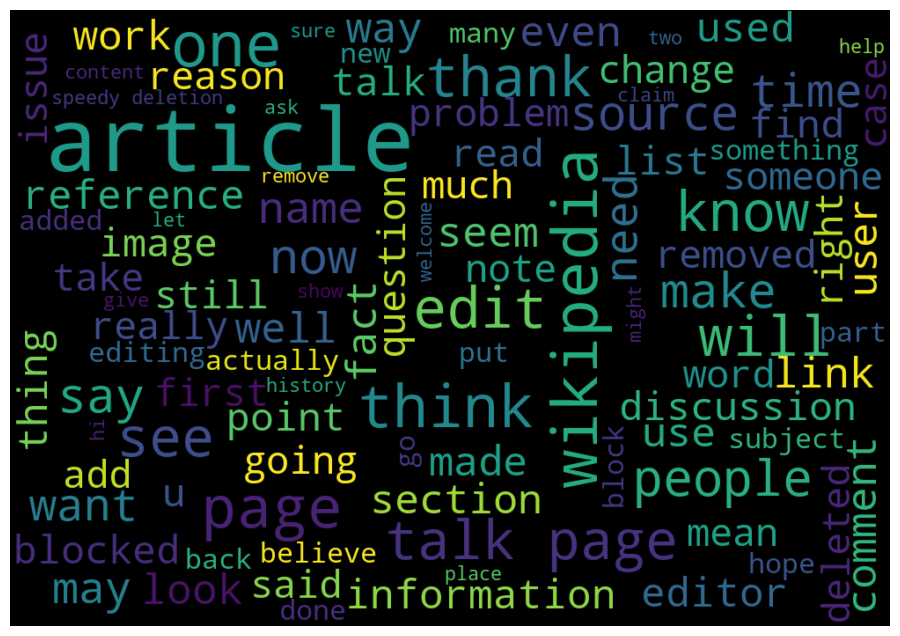

In [19]:
all_train_txt = ' '.join(comm for comm in train['comment_text'])

plt.figure(figsize=(15, 8))

wordcloud_all = WordCloud(
    stopwords=STOPWORDS,
    background_color='black',
    max_font_size=100,
    max_words=100,
    width=1000,
    height=700
).generate(all_train_txt)

plt.imshow(wordcloud_all, interpolation='bilinear')
plt.axis('off')
plt.show()

#### Hatespeach only

In [20]:
toxic_data = train[train['neutral'] == 0].reset_index(drop=True)
toxic_data = toxic_data.drop('neutral', axis=1)
len(toxic_data)

15826

Piece of data for training:

In [21]:
toxic_data = toxic_data.sample(frac=0.75, random_state=RANDOM_SEED, ignore_index=True)
len(toxic_data)

11870

In [22]:
fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=('toxic', 'severe_toxic', 'obscene',
                    'threat', 'insult', 'identity_hate')
                    )

for i, column in enumerate(toxic_data.columns[2:-1]):
    fig.add_trace(
        go.Histogram(x=toxic_data[column], name=column),
        row=1 + (i // 3),
        col=1 + (i % 3)
    )

for i in range(1, 3):
    for j in range(1, 4):
        fig.update_xaxes(
            tickvals=[0, 1],
            row=i, col=j
        )

fig.update_layout(
    width=900,
    height=800,
    title_text='Distribution of data by toxicity',
    title_x=0.5,
    bargap=0.1
)

fig.show()

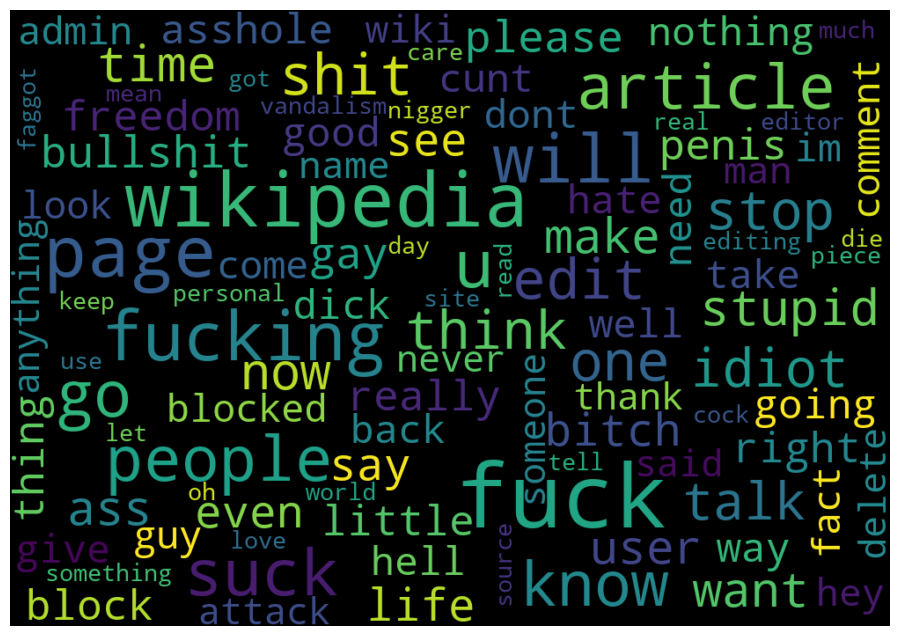

In [23]:
all_toxic_data_txt = ' '.join(comm for comm in toxic_data['comment_text'])

plt.figure(figsize=(15, 8))

wordcloud_all = WordCloud(
    stopwords=STOPWORDS,
    background_color='black',
    collocations=False,
    max_font_size=100,
    max_words=100,
    width=1000,
    height=700,
    random_state=RANDOM_SEED
).generate(all_toxic_data_txt)

plt.imshow(wordcloud_all, interpolation='bilinear')
plt.axis('off')
plt.show()

#### Tokenization toxic data & Embeddings

In [24]:
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

device

device(type='cuda')

In [25]:
batch_embeddings = 32

dataloader = DataLoader(
    toxic_data['comment_text'].tolist(),
    batch_size=batch_embeddings,
    shuffle=False)

In [26]:
def process_batch(batch_comments):
    tokenizer = AutoTokenizer.from_pretrained('cointegrated/LaBSE-en-ru')
    model = AutoModel.from_pretrained('cointegrated/LaBSE-en-ru').to(device)
    
    inputs = tokenizer(
        batch_comments,
        truncation=True,
        padding='max_length',
        max_length=512,
        return_tensors='pt'
    ).to(device)
    
    with torch.no_grad():
        outputs = model(**inputs)
        embeddings = outputs.pooler_output
        embeddings = torch.nn.functional.normalize(embeddings)
    return embeddings

In [27]:
toxic_embeddings = []

for batch in tqdm(dataloader):
    with torch.no_grad():
        embeddings = process_batch(batch)
        toxic_embeddings.extend(embeddings.cpu().numpy())

100%|██████████| 371/371 [07:10<00:00,  1.16s/it]


In [28]:
toxic_embeddings = np.array(toxic_embeddings)
toxic_data['embeddings'] = list(toxic_embeddings)

#### KMeans

In [29]:
embeddings = toxic_data['embeddings'].to_list()

kmeans_data = toxic_data['embeddings']
kmeans_data.head()

0    [0.022968708, 0.011208576, -0.06918391, -0.07347886, 0.032438148, 0.03508219, -0.05848155, -0.0057149893, 0.009201116, 0.031441, -0.0013893914, -0.057708222, -0.055054665, -0.04090892, 0.0110066505, -0.022093387, 0.01448439, -0.064553246, -0.022303322, -0.058044154, 0.028144464, -0.0030003202, -...
1    [-0.012946911, 0.014386593, 0.01718619, -0.0680479, 0.014265391, 0.014667129, -0.046686146, -0.038488206, 0.07677893, -0.03457665, 0.05153495, 0.043733153, 0.03114413, -0.081330374, 0.036219854, -0.050086543, -0.0021588716, 0.005094413, 0.016333003, -0.040303946, -0.02034582, -0.05190813, -0.031...
2    [0.023270251, -0.03376733, -0.0016329205, -0.04904688, 0.0488861, 0.0075152735, -0.07233495, 0.0006996469, 0.031613447, -0.029518649, 0.019984107, -0.010426008, -0.010979131, -0.016079234, 0.06161639, 0.00013612086, 0.06511824, 0.05383533, -0.02317735, 0.024352603, -0.039019134, -0.06163126, -0....
3    [0.056645595, -0.07135301, 0.033925902, -0.045568578, 0.015565287, -0.02480189, 

In [30]:
scaler = StandardScaler()
X = scaler.fit_transform(embeddings)

X.shape

(11870, 768)

In [31]:
def clust_plots(X_tsne, X_pca, title=None, hue=None):
    fig = make_subplots(rows=1, cols=2,
                        specs=[[{'is_3d': True}, {'is_3d': True}]],
                        subplot_titles=('TSNE', 'PCA'))
    fig.add_trace(
        go.Scatter3d(
            x=X_tsne[:, 0],
            y=X_tsne[:, 1],
            z=X_tsne[:, 2],
            mode='markers',
            marker=dict(color=hue, colorscale='rainbow', size=1),
        ),
        row=1, col=1,
    )
    fig.add_trace(
        go.Scatter3d(
            x=X_pca[:, 0],
            y=X_pca[:, 1],
            z=X_pca[:, 2],
            mode='markers',
            marker=dict(color=hue, colorscale='rainbow', size=1),
        ),
        row=1, col=2,
    )
    fig.update_layout(
        title=title,
        showlegend=False,
    )
    fig.show()

In [32]:
tsne = TSNE(n_components=3, random_state=RANDOM_SEED)
X_tsne = tsne.fit_transform(X)

pca = PCA(n_components=3, random_state=RANDOM_SEED)
X_pca = pca.fit_transform(X)

clust_plots(X_tsne, X_pca)

26it [00:52,  2.20s/it]                        


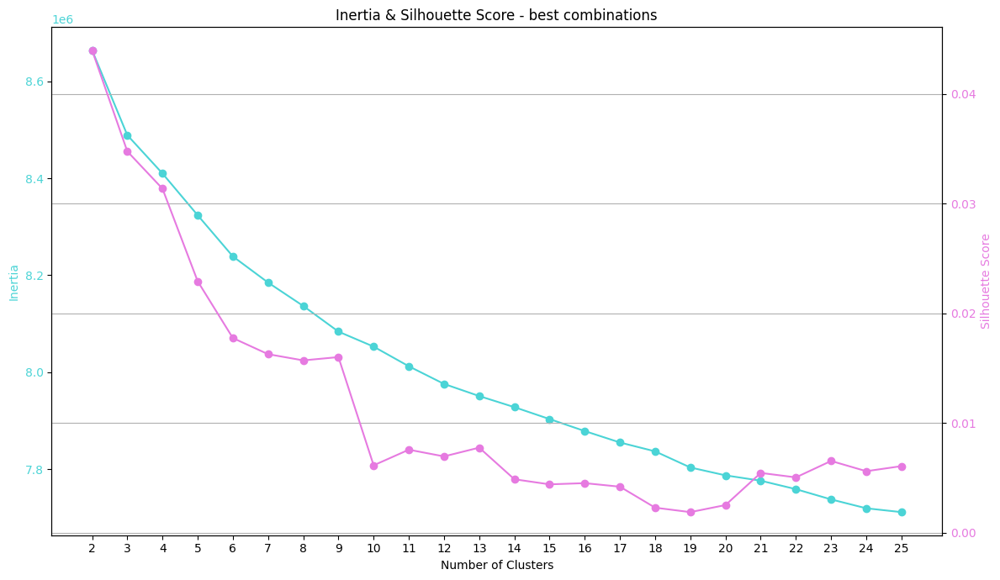

In [33]:
inertia = []
score_kmeans = []
for n_clusters in tqdm(np.arange(2,26), initial=2):
    kmeans = KMeans(n_clusters=n_clusters, random_state=RANDOM_SEED).fit(X)
    
    inertia_clusters = kmeans.inertia_
    inertia.append(inertia_clusters)

    clustering = kmeans.predict(X)
    silhouette = silhouette_score(X, clustering)
    score_kmeans.append(silhouette)

fig, ax1 = plt.subplots(figsize=(12, 7))

ax1.set_xlabel('Number of Clusters')
plt.xticks(np.arange(2, 26, 1))
ax1.set_ylabel('Inertia', color='#4bd4d6')
ax1.plot(np.arange(2, 26), inertia, marker='o', color='#4bd4d6')
ax1.tick_params(axis='y', labelcolor='#4bd4d6')

ax2 = ax1.twinx()
ax2.set_ylabel('Silhouette Score', color='#e67ae0')
ax2.plot(np.arange(2, 26), score_kmeans, marker='o', color='#e67ae0')
ax2.tick_params(axis='y', labelcolor='#e67ae0')

plt.title('Inertia & Silhouette Score - best combinations')
plt.tight_layout()
plt.grid(True)
plt.show()

##### 4 clusters

In [34]:
toxic_data_4 = toxic_data.copy()

In [35]:
kmeans_4 = KMeans(n_clusters=4, random_state=RANDOM_SEED)
toxic_data_4['kmeans_clusters'] = kmeans_4.fit_predict(X)

In [36]:
clust_plots(X_tsne, X_pca, hue=toxic_data_4['kmeans_clusters'])

In [37]:
cluster_0 = toxic_data_4[toxic_data_4['kmeans_clusters'] == 0]
cluster_1 = toxic_data_4[toxic_data_4['kmeans_clusters'] == 1]
cluster_2 = toxic_data_4[toxic_data_4['kmeans_clusters'] == 2]
cluster_3 = toxic_data_4[toxic_data_4['kmeans_clusters'] == 3]

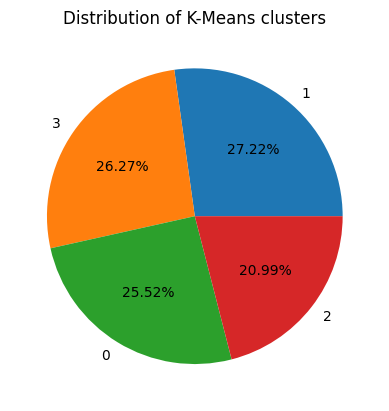

In [38]:
plt.pie(
    toxic_data_4['kmeans_clusters'].value_counts(),
    autopct='%1.2f%%',
    labels=toxic_data_4['kmeans_clusters'].unique())
plt.title('Distribution of K-Means clusters')
plt.show()

In [39]:
def wordcloud_cluster(cluster):

    cluster_txt = ' '.join(comm for comm in cluster['comment_text'])

    plt.figure(figsize=(15, 8))

    wordcloud_cluster = WordCloud(
        stopwords=STOPWORDS,
        background_color='black',
        collocations=False,
        max_font_size=100,
        max_words=100,
        width=1000,
        height=700,
        random_state=RANDOM_SEED
    ).generate(cluster_txt)

    plt.imshow(wordcloud_cluster, interpolation='bilinear')
    plt.axis('off')
    plt.show()

    Sample №1: ['" i nearly get blocked? lol. i didn\'t broke any rule, i even was reported for breaking the wp:rr and i didn\'t get blocked because i didn\'t broke it. check the log. you even asked spellcast to block me because you\'re not thinking clearly. how is he going to block when i haven\'t done anything wrong? you mad? it\'s a zero! "']
    Sample №2: ["if people revert my edits for no good reason, i get pissed off. don't you? and if someone is so utterly retarded as to somehow mistake them for vandalism, and to then leave a message here to say so, i think that is far more abusive than merely using a swear word. ..."]
    Sample №3: ['" just as well that this ""isn\'t a problem"", as your imbecilic behaviour has gotten you added to the target list! whilst i\'m here, let good ol\' mr slick know that i have put th june in my diary. i\'ll be there the second that s-protection expires to sort his talk page out. ... "']
    Sample №4: ["wow holy fuck this girl is hot as hell. i kno

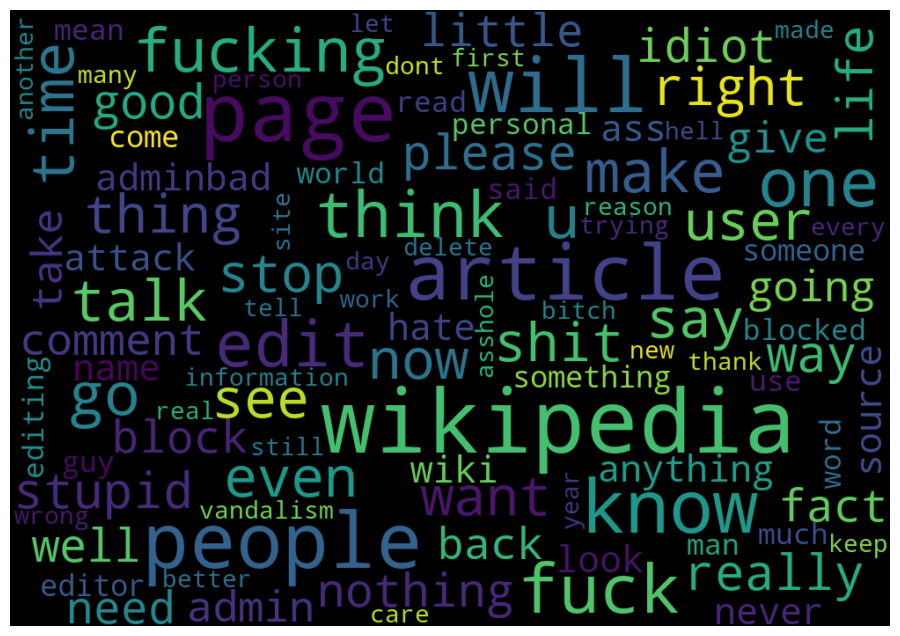

In [40]:
print(
    f'    Sample №1: {cluster_0['comment_text'].sample(1).values}\n\
    Sample №2: {cluster_0['comment_text'].sample(1).values}\n\
    Sample №3: {cluster_0['comment_text'].sample(1).values}\n\
    Sample №4: {cluster_0['comment_text'].sample(1).values}\n\
    Sample №5: {cluster_0['comment_text'].sample(1).values}'
    )
wordcloud_cluster(cluster_0)

    Sample №1: ['he can go fuck himself sideways with a spiky spoon.']
    Sample №2: ['oi will you fuck off?????']
    Sample №3: ['you are a pathetic, lifeless fuck.']
    Sample №4: ['so many children to abuse so little time']
    Sample №5: ['you can fuck off too, you twatus majorus.']


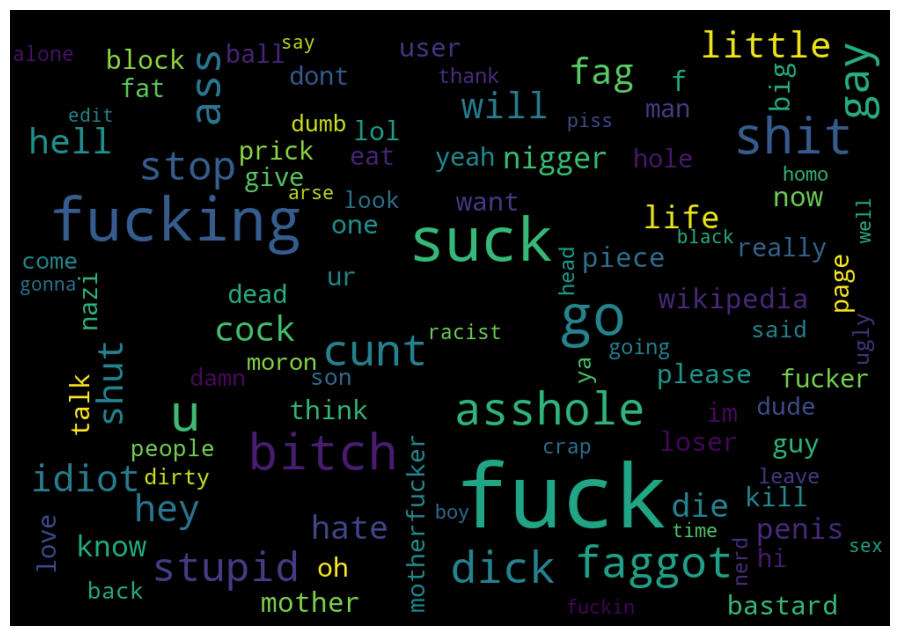

In [41]:
print(
    f'    Sample №1: {cluster_1['comment_text'].sample(1).values}\n\
    Sample №2: {cluster_1['comment_text'].sample(1).values}\n\
    Sample №3: {cluster_1['comment_text'].sample(1).values}\n\
    Sample №4: {cluster_1['comment_text'].sample(1).values}\n\
    Sample №5: {cluster_1['comment_text'].sample(1).values}'
    )
wordcloud_cluster(cluster_1)

    Sample №1: ["levantine arabs are white you complete moron the white latin american page has shakira's photo who is half-arab"]
    Sample №2: ['time cube you have been educated singularity stupid you mindless academic cannibal.']
    Sample №3: ['douche? dear s, be you a douchecock? i believe it doubly so.']
    Sample №4: ['stop being a shithead, or i will rip off your head and piss down your esophagus, mother fucker. we came in?']
    Sample №5: ['fap so i herd u were still a fucking wanker. is this true? (ps: guess who, ?)']


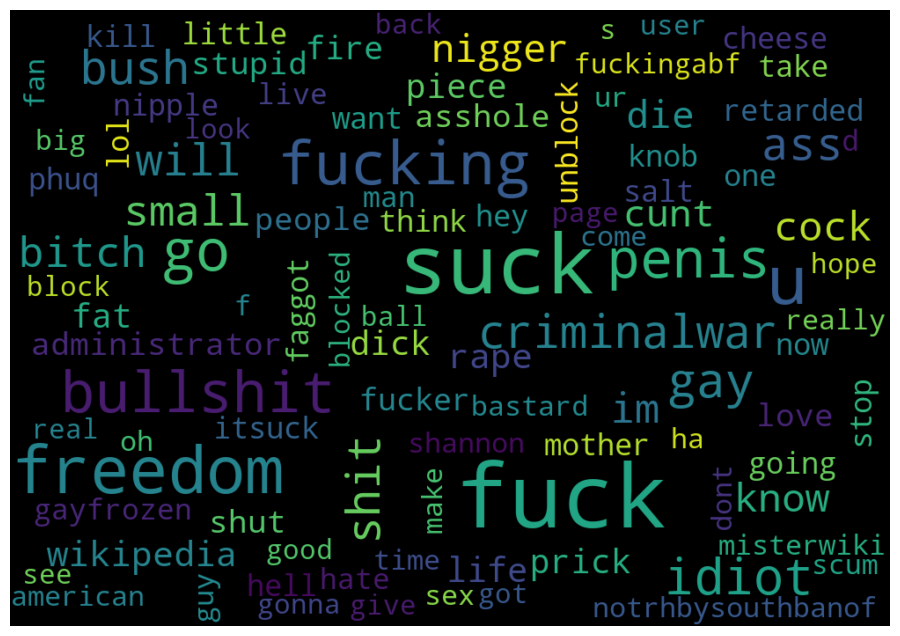

In [42]:
print(
    f'    Sample №1: {cluster_2['comment_text'].sample(1).values}\n\
    Sample №2: {cluster_2['comment_text'].sample(1).values}\n\
    Sample №3: {cluster_2['comment_text'].sample(1).values}\n\
    Sample №4: {cluster_2['comment_text'].sample(1).values}\n\
    Sample №5: {cluster_2['comment_text'].sample(1).values}'
    )
wordcloud_cluster(cluster_2)

    Sample №1: ["this article sucks i would nominate it for deletion if it wasn't protected."]
    Sample №2: ['your recent stupidity please refrain from being stupid. your recent ignorance has been reverted. next time you try to supress the truth you will be blocked. thank you, the truth teller']
    Sample №3: ['the article clearly sucks.']
    Sample №4: ['_ reignman is a really ignorant person, and a perfect example of why wikipedia is not to be trusted. _']
    Sample №5: ['excuse me??? are u alowed to talk to me that way? i am not a troll i am a human being. u racist.']


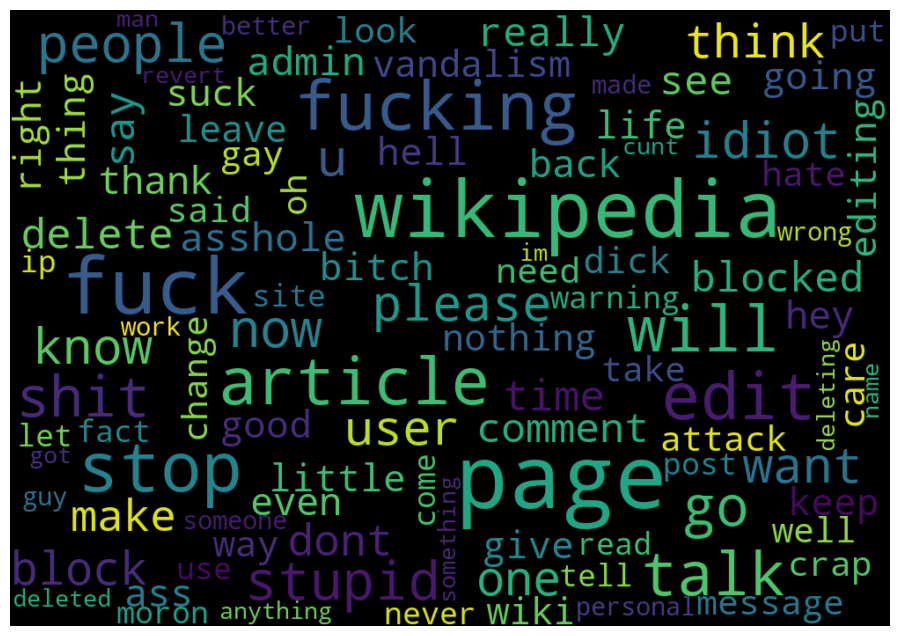

In [43]:
print(
    f'    Sample №1: {cluster_3['comment_text'].sample(1).values}\n\
    Sample №2: {cluster_3['comment_text'].sample(1).values}\n\
    Sample №3: {cluster_3['comment_text'].sample(1).values}\n\
    Sample №4: {cluster_3['comment_text'].sample(1).values}\n\
    Sample №5: {cluster_3['comment_text'].sample(1).values}'
    )
wordcloud_cluster(cluster_3)